In [1]:
# import modin.config as cfg
# cfg.StorageFormat.put('hdk')
# import modin.pandas as pd

import pandas as pd

In [2]:
from sklearnex import patch_sklearn
patch_sklearn()

Intel(R) Extension for Scikit-learn* enabled (https://github.com/intel/scikit-learn-intelex)


In [3]:
import os
import time
import warnings
import numpy as np

from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV, RandomizedSearchCV
from sklearn.metrics import roc_auc_score, roc_curve, auc, accuracy_score, f1_score
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.svm import SVC
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import StandardScaler, OneHotEncoder, RobustScaler
from sklearn.experimental import enable_iterative_imputer
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.impute import SimpleImputer, KNNImputer, IterativeImputer
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import cross_val_score, StratifiedKFold

import daal4py as d4p
import matplotlib.colors
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [4]:
start_read = time.time()
raw = pd.read_csv("500k_dataset.csv")
# raw = pd.read_csv("dataset.csv")
print("read csv took: {:.2f} s".format(time.time() - start_read))

selected_columns = ['Color', 'Turbidity', 'Copper', 'Manganese', 'Chloride', 'Iron','Fluoride', 'Nitrate',
                    'Odor', 'Chlorine', 'Sulfate', 'Total Dissolved Solids', 'Zinc', 'pH', 'Target']
data = raw.loc[:, selected_columns]

print("Total rows in the DataFrame:", len(data))
display(data.head())

read csv took: 1.92 s
Total rows in the DataFrame: 595684


,Color,Turbidity,Copper,Manganese,Chloride,Iron,Fluoride,Nitrate,Odor,Chlorine,Sulfate,Total Dissolved Solids,Zinc,Lead,pH,Target
0,Yellow,0.231956,0.715433,4.484932e-01,119.769705,1.154674e-17,2.108228,7.631200,1.081976,3.270075,230.194138,91.539583,2.693937,6.350348e-86,6.737944,1
1,Light Yellow,1.051458,0.773502,1.540051e+00,150.015099,3.600729e-03,1.422666,11.236134,0.503722,4.001868,88.068009,86.764591,3.590989,3.992670e-61,8.574330,1
2,Near Colorless,0.001308,0.037652,3.190700e-07,126.665161,2.242093e-01,0.718139,9.838300,3.102165,3.743012,92.617198,396.609596,1.265744,8.205945e-08,6.754215,0
3,Near Colorless,0.001784,0.206894,7.835654e-03,90.619648,9.019033e-08,0.139084,4.363331,1.703149,3.854285,209.857103,201.327892,1.583872,1.850471e-138,7.573689,0
4,Faint Yellow,0.733317,1.005681,8.823558e-07,212.130670,9.183142e-07,0.179237,9.636736,0.561782,2.222523,117.492988,293.961541,0.800412,7.907960e-56,7.316263,0


In [5]:
# handle missing values
start = time.time()

# cat_imputer = SimpleImputer(strategy='most_frequent')
# # num_imputer = IterativeImputer(estimator=RandomForestRegressor(n_estimators=5, random_state=0, n_jobs=-1), max_iter=5)
# num_imputer = KNNImputer(n_neighbors=2)

# cat_cols = data.select_dtypes(include=['object']).columns
# num_cols = data.select_dtypes(exclude=['object']).columns

# data[cat_cols] = cat_imputer.fit_transform(data[cat_cols])
# # data[num_cols] = num_imputer.fit_transform(data[num_cols])
# for col in num_cols:
#     data[col] = data[col].interpolate(method='linear')

data.dropna(subset=data.columns, inplace=True)

print("handle missing value took: {:.2f} s".format(time.time() - start))

handle missing value took: 0.13 s


In [6]:
# color_dict = {
#     'Colorless': 0,
#     'Near Colorless': 1,
#     'Faint Yellow': 2,
#     'Light Yellow': 3,
#     'Yellow': 4
# }
# data['Color'] = data['Color'].map(color_dict)

In [7]:
# handle outliers
start = time.time()

handle_upper_cols = ['Iron', 'Lead', 'Zinc', 'Turbidity', 'Fluoride', 'Copper', 'Manganese', 'Nitrate',
                     'Chloride','Sulfate','Chlorine','Water Temperature','Air Temperature', 'Odor', 'Conductivity']
handle_lower_cols = ['Nitrate','Chloride', 'Sulfate','Chlorine', 'Air Temperature', 'Odor', 'Conductivity']

for col in data.columns:
    if data[col].dtype == 'object':
        continue
    lower, upper = np.percentile(data[col], [1, 99])
    if col in handle_upper_cols:
        data.loc[data[col] > upper, col] = upper
    if col in handle_lower_cols:
        data.loc[data[col] < lower, col] = lower

print("handle outliers took: {:.2f} s".format(time.time() - start))

handle outliers took: 0.10 s


In [8]:
# handle distribution

# start = time.time()

# from scipy.stats import yeojohnson
# for col in ['Nitrate','Chloride','Turbidity','Sulfate']:
#     if col in data.columns:
#         data[col] = np.log1p(data[col])

# for col in ['Iron','Lead','Manganese']:
#     if col in data.columns:
#         data[col], _ = yeojohnson(data[col])

# scaler = StandardScaler()
# for col in ['Total Dissolved Solids', 'Water Temperature', 'Air Temperature']:
#     if col not in data.columns:
#         continue
#     data[col] = scaler.fit_transform(data[[col]])

# print("handle distribution took: {:.2f} s".format(time.time() - start))

In [9]:
# discretize features
start = time.time()

labels_dict = {
    'pH': ['Acidic', 'Neutral', 'Alkaline'],
#     'Odor': ['No Odor', 'Slight Odor', 'Noticeable Odor', 'Strong Odor']
}

data['pH'] = pd.cut(data['pH'], bins=[0, 6.5, 8.5, 14], labels=labels_dict['pH'], include_lowest=True)
# data['Odor'] = pd.cut(data['Odor'], bins=[-np.inf, 1, 2, 3, np.inf], labels=labels_dict['Odor'], include_lowest=True)

# transform labels to numerics
# for _, column in enumerate(['pH', 'Odor']):
#     if column not in data:
#         continue

#     if column in labels_dict:
#         labels = labels_dict[column]
#         category = pd.Categorical(data[column], categories=labels, ordered=True)
#         data[column] = category.codes
#     else:
#         codes, labels = pd.factorize(data[column])
#         data[column] = codes

data = pd.get_dummies(data, columns=['pH', 'Color'], drop_first=False)

print("discretize features took: {:.2f} s".format(time.time() - start))

discretize features took: 0.08 s


In [10]:
# drop duplicated rows
start = time.time()
data = data.drop_duplicates()
print("drop duplicates took: {:.2f} s".format(time.time() - start))

# check data
missing = data.isna().sum().sum()
duplicates = data.duplicated().sum()
print("\nThere are {:,.0f} missing values in the data.".format(missing))
print("There are {:,.0f} duplicate records in the data.".format(duplicates))

display(data.head())

drop duplicates took: 0.47 s

There are 0 missing values in the data.
There are 0 duplicate records in the data.


,Turbidity,Copper,Manganese,Chloride,Iron,Fluoride,Nitrate,Odor,Chlorine,Sulfate,Total Dissolved Solids,Zinc,Lead,pH,Target,Color_Colorless,Color_Faint Yellow,Color_Light Yellow,Color_Near Colorless,Color_Yellow
0,0.231956,0.715433,4.484932e-01,119.769705,1.154674e-17,2.108228,7.631200,1.081976,3.270075,230.194138,91.539583,2.693937,6.350348e-86,6.737944,1,0,0,0,0,1
1,1.051458,0.773502,1.540051e+00,150.015099,3.600729e-03,1.422666,11.236134,0.503722,4.001868,88.068009,86.764591,3.590989,3.992670e-61,8.574330,1,0,0,1,0,0
2,0.001308,0.037652,3.190700e-07,126.665161,2.242093e-01,0.718139,9.838300,3.102165,3.743012,92.617198,396.609596,1.265744,8.205945e-08,6.754215,0,0,0,0,1,0
3,0.001784,0.206894,7.835654e-03,90.619648,9.019033e-08,0.139084,4.363331,1.703149,3.854285,209.857103,201.327892,1.583872,1.850471e-138,7.573689,0,0,0,0,1,0
4,0.733317,1.005681,8.823558e-07,212.130670,9.183142e-07,0.179237,9.636736,0.561782,2.222523,117.492988,293.961541,0.800412,7.907960e-56,7.316263,0,0,1,0,0,0


In [11]:
def prepare_train_test_data(data, target_col, test_size):
    
    """
    Function to scale and split the data into training and test sets
    """
    
    scaler = RobustScaler()   
    X = data.drop(target_col, axis=1)
    y = data[target_col]
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=21)
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)
    print("Train Shape: {}".format(X_train_scaled.shape))
    print("Test Shape: {}".format(X_test_scaled.shape))
    
    return X_train_scaled, X_test_scaled, y_train, y_test

def plot_model_res(model_name, y_test, y_prob):
    
    """
    Function to plot ROC/PR Curves and predicted target distribution
    """
    
    intel_pal=['#0071C5','#FCBB13']
    color=['#7AB5E1','#FCE7B2']
    
    ## ROC & PR Curve ##
    fpr, tpr, _ = roc_curve(y_test, y_prob)
    roc_auc = auc(fpr,tpr)
    precision, recall, _ = precision_recall_curve(y_test, y_prob)
    auprc = average_precision_score(y_test, y_prob)
    
    fig = make_subplots(rows=1, cols=2, 
                        shared_yaxes=True, 
                        subplot_titles=['Receiver Operating Characteristic<br>(ROC) Curve',
                                        'Precision-Recall Curve<br>AUPRC = {:.3f}'.format(auprc)])
    
    fig.add_trace(go.Scatter(x=np.linspace(0,1,11), y=np.linspace(0,1,11), 
                             name='Baseline',mode='lines',legendgroup=1,
                             line=dict(color="Black", width=1, dash="dot")), row=1,col=1)    
    fig.add_trace(go.Scatter(x=fpr, y=tpr, line=dict(color=intel_pal[0], width=3), 
                             hovertemplate = 'True positive rate = %{y:.3f}, False positive rate = %{x:.3f}',
                             name='AUC = {:.4f}'.format(roc_auc),legendgroup=1), row=1,col=1)
    fig.add_trace(go.Scatter(x=recall, y=precision, line=dict(color=intel_pal[0], width=3), 
                             hovertemplate = 'Precision = %{y:.3f}, Recall = %{x:.3f}',
                             name='AUPRC = {:.4f}'.format(auprc),showlegend=False), row=1,col=2)
    fig.update_layout(title="{} ROC and Precision-Recall Curves".format(model_name), 
                      hovermode="x unified", width=900,height=500,
                      xaxis1_title='False Positive Rate (1 - Specificity)',
                      yaxis1_title='True Positive Rate (Sensitivity)',
                      xaxis2_title='Recall (Sensitivity)',yaxis2_title='Precision (PPV)',
                      legend=dict(orientation='v', y=.07, x=.45, xanchor="right",
                                  bordercolor="black", borderwidth=.5))
    fig.show()
    
    ## Target Distribution ##     
    plot_df=pd.DataFrame.from_dict({'State 0':(len(y_prob[y_prob<=0.5])/len(y_prob))*100, 
                                    'State 1':(len(y_prob[y_prob>0.5])/len(y_prob))*100}, 
                                   orient='index', columns=['pct'])
    fig=go.Figure()
    fig.add_trace(go.Pie(labels=plot_df.index, values=plot_df.pct, hole=.45, 
                         text=plot_df.index, sort=False, showlegend=False,
                         marker=dict(colors=color,line=dict(color=intel_pal,width=2.5)),
                         hovertemplate = "%{label}: <b>%{value:.2f}%</b><extra></extra>"))
    fig.update_layout(title='Predicted Target Distribution',width=700,height=450,
                      uniformtext_minsize=15, uniformtext_mode='hide')
    fig.show()

In [12]:
## Prepare Train and Test datasets ##
print("Preparing Train and Test datasets")
X_train, X_test, y_train, y_test = prepare_train_test_data(data=data, 
                                                            target_col='Target', 
                                                            test_size=.25)

Preparing Train and Test datasets
Train Shape: (338796, 19)
Test Shape: (112932, 19)



Tuning hyperparameters..
Fitting 3 folds for each of 5 candidates, totalling 15 fits


/home/u188545/.local/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/linear_model/_sag.py:35

Done!
Best hyperparameters: {'solver': 'newton-cg', 'penalty': 'l2', 'C': 0.31622776601683794}
Best cross-validation AUC: 0.8611
Tune hyperparameter took:  19.738903999328613

Test F1 accuracy: 70.64%, AUC: 0.86175


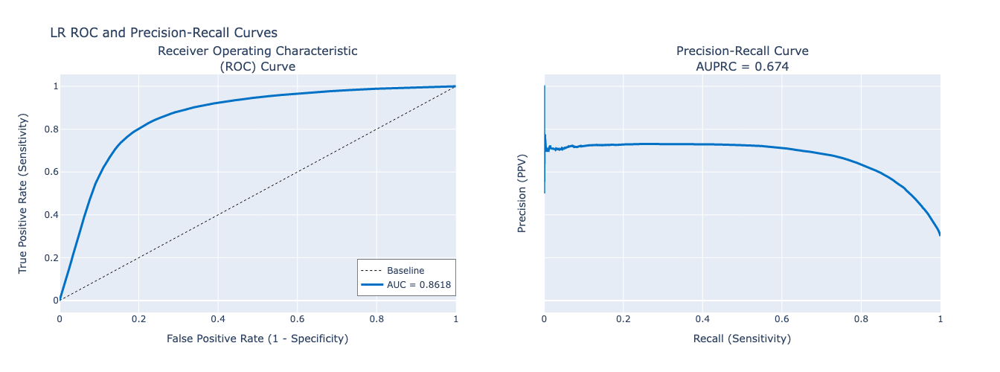

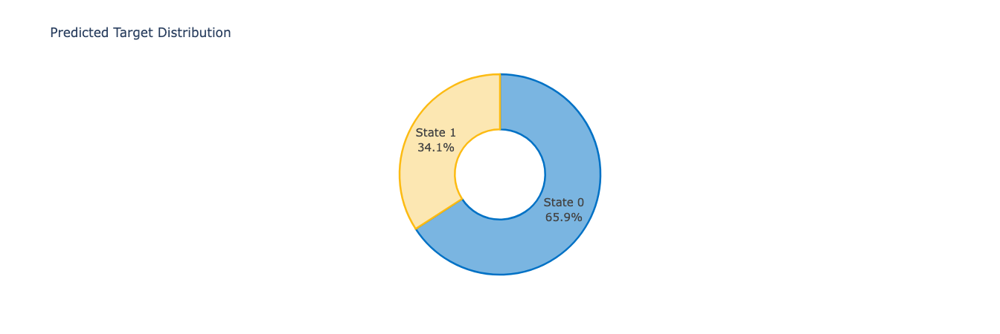

In [13]:
## Initialize LR model ##
parameters = {
    'class_weight': 'balanced',
    'random_state': 21
}
lr = LogisticRegression(**parameters)

## Tune Hyperparameters ##
# {'solver': 'lbfgs', 'penalty': 'l2', 'C': 0.09999999999999999}
start_tune = time.time()
strat_kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=21)
print("\nTuning hyperparameters..")
grid = {
    'C': np.logspace(-1, 1, 5),
    'penalty': ['l2'],
    'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']
}
grid_search = RandomizedSearchCV(lr, param_distributions=grid, 
                                    cv=strat_kfold, n_iter=5, scoring='roc_auc', 
                                    verbose=1, n_jobs=-1, random_state=21)
grid_search.fit(X_train, y_train)
    
print("Done!\nBest hyperparameters:", grid_search.best_params_)
print("Best cross-validation AUC: {:.4f}".format(grid_search.best_score_))
print("Tune hyperparameter took: ", time.time() - start_tune)

lr = grid_search.best_estimator_
lr_prob = lr.predict_proba(X_test)[:,1]
lr_pred = pd.Series(lr.predict(X_test), name='Target')
lr_auc = roc_auc_score(y_test, lr_prob)
lr_f1 = f1_score(y_test, lr_pred)  
   
## Print model results ##
print("\nTest F1 accuracy: {:.2f}%, AUC: {:.5f}".format(lr_f1*100,lr_auc))
plot_model_res(model_name='LR', y_test=y_test, y_prob=lr_prob)

In [14]:
# ## Initialize SVC model ##
# parameters = {
#     'class_weight': 'balanced',
#     'probability': True,
#     'random_state': 21}
# svc = SVC(**parameters)

# ## Tune Hyperparameters ##
# # 10k: {'kernel': 'rbf', 'C': 1.0}
# start_tune = time.time()
# strat_kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=21)
# print("\nTuning hyperparameters..")
# grid = {
#     'C': np.logspace(-1, 1, 5),
#     'gamma': ['scale', 'auto', 0.1, 1, 10, 100], 
#     'kernel': ['linear', 'poly', 'rbf', 'sigmoid']
#     }
# grid_search = RandomizedSearchCV(svc, param_distributions=grid, 
#                                     cv=strat_kfold, n_iter=5, scoring='roc_auc', 
#                                     verbose=1, n_jobs=-1, random_state=21)
# grid_search.fit(X_train, y_train)
    
# print("Done!\nBest hyperparameters:", grid_search.best_params_)
# print("Best cross-validation AUC: {:.4f}".format(grid_search.best_score_))
# print("Tune hyperparameter took: ", time.time() - start_tune)

# svc = grid_search.best_estimator_
# svc_prob = svc.predict_proba(X_test)[:,1]
# svc_pred = pd.Series(svc.predict(X_test), name='Target')
# svc_auc = roc_auc_score(y_test, svc_prob)
# svc_f1 = f1_score(y_test, svc_pred)  
   
# ## Print model results ##
# print("\nTest F1 accuracy: {:.2f}%, AUC: {:.5f}".format(svc_f1*100,svc_auc))
# plot_model_res(model_name='SVC', y_test=y_test, y_prob=svc_prob)


Tuning hyperparameters..
Fitting 3 folds for each of 45 candidates, totalling 135 fits
Done!
Best hyperparameters: {'gamma': 1, 'max_depth': 5, 'min_child_weight': 5}
Best cross-validation AUC: 0.9184
Tune hyperparameter took:  47.79370713233948

Test F1 Accuracy: 82.29%, AUC: 0.91889


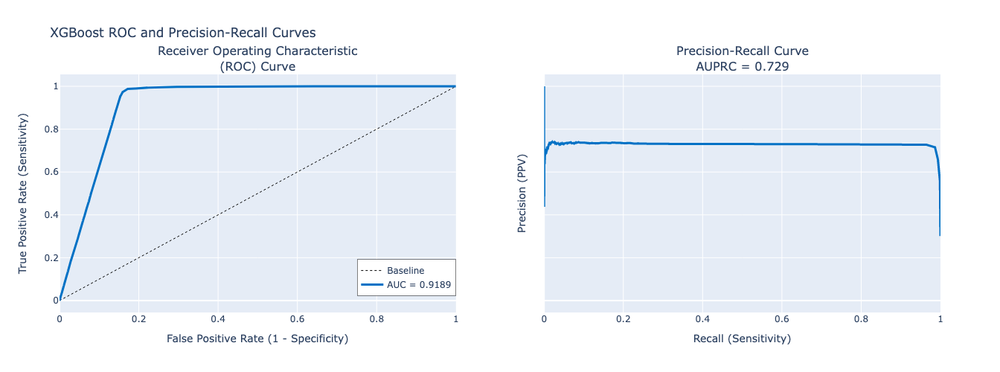

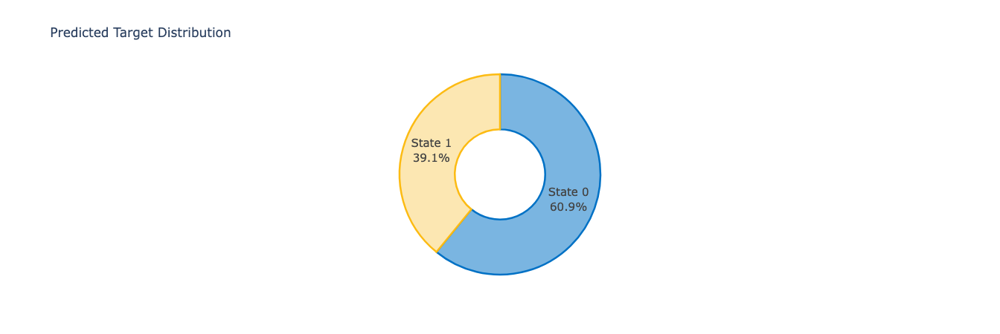

In [15]:
## Initialize XGBoost model ##
ratio = float(np.sum(y_train == 0)) / np.sum(y_train == 1)
parameters = {'scale_pos_weight': ratio.round(2), 
                'tree_method': 'hist',
                'random_state': 21}
xgb_model = XGBClassifier(**parameters)

## Tune hyperparameters ##
# 10k: {'gamma': 5, 'max_depth': 5, 'min_child_weight': 5}
start_tune = time.time()
strat_kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=21)
print("\nTuning hyperparameters..")
grid = {
    'min_child_weight': [1, 5, 10],
    'gamma': [0.5, 1, 1.5, 2, 5],
    'max_depth': [3, 4, 5],
}

grid_search = GridSearchCV(xgb_model, param_grid=grid, 
                            cv=strat_kfold, scoring='roc_auc', 
                            verbose=1, n_jobs=-1)
grid_search.fit(X_train, y_train)

print("Done!\nBest hyperparameters:", grid_search.best_params_)
print("Best cross-validation AUC: {:.4f}".format(grid_search.best_score_))
print("Tune hyperparameter took: ", time.time() - start_tune)

## Convert XGB model to daal4py ##
xgb = grid_search.best_estimator_
daal_model = d4p.get_gbt_model_from_xgboost(xgb.get_booster())

## Calculate predictions ##
daal_prob = d4p.gbt_classification_prediction(nClasses=2,
    resultsToEvaluate="computeClassLabels|computeClassProbabilities",
    fptype='float').compute(X_test, daal_model).probabilities # or .predictions
xgb_pred = pd.Series(np.where(daal_prob[:,1]>.5, 1, 0), name='Target')
xgb_auc = roc_auc_score(y_test, daal_prob[:,1])
xgb_f1 = f1_score(y_test, xgb_pred)  
    
## Plot model results ##
print("\nTest F1 Accuracy: {:.2f}%, AUC: {:.5f}".format(xgb_f1*100, xgb_auc)) 
plot_model_res(model_name='XGBoost', y_test=y_test, y_prob=daal_prob[:,1])


Tuning hyperparameters..
Fitting 3 folds for each of 5 candidates, totalling 15 fits
Done!
Best hyperparameters: {'n_estimators': 200, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_depth': 20, 'bootstrap': False}
Best cross-validation AUC: 0.9184
Tune hyperparameter took:  185.34101581573486

Test F1 accuracy: 83.22%, AUC: 0.91844


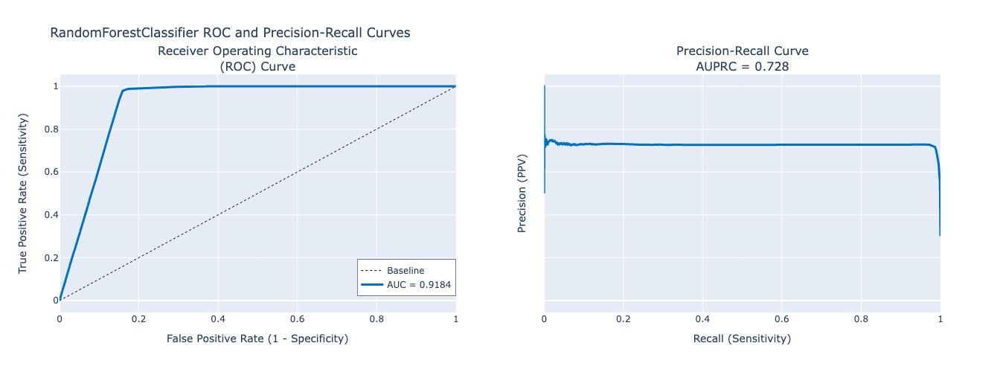

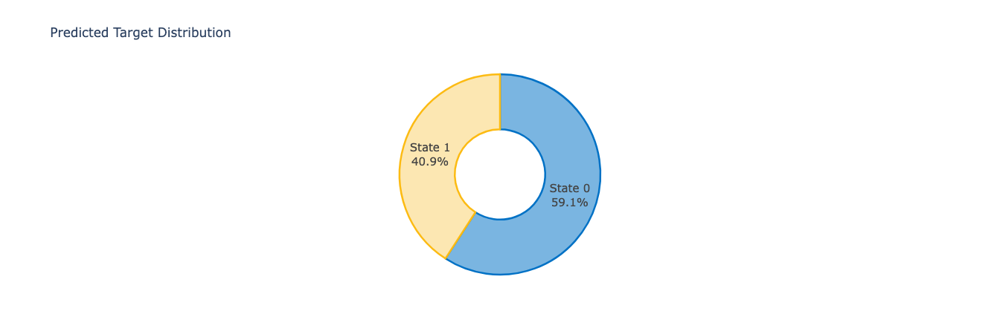

In [16]:
## Initialize RandomForestClassifier model ##
parameters = {
    'class_weight': 'balanced',
    'random_state': 21}
rfc = RandomForestClassifier(**parameters)

## Tune Hyperparameters ##
# {'n_estimators': 200, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_depth': 10, 'bootstrap': True}
start_tune = time.time()
strat_kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=21)
print("\nTuning hyperparameters..")
grid = {
    'n_estimators': [10, 50, 100, 200, 500],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}
grid_search = RandomizedSearchCV(rfc, param_distributions=grid, 
                                    cv=strat_kfold, n_iter=5, scoring='roc_auc', 
                                    verbose=1, n_jobs=-1, random_state=21)
grid_search.fit(X_train, y_train)
    
print("Done!\nBest hyperparameters:", grid_search.best_params_)
print("Best cross-validation AUC: {:.4f}".format(grid_search.best_score_))
print("Tune hyperparameter took: ", time.time() - start_tune)

rfc = grid_search.best_estimator_
rfc_prob = rfc.predict_proba(X_test)[:,1]
rfc_pred = pd.Series(rfc.predict(X_test), name='Target')
rfc_auc = roc_auc_score(y_test, rfc_prob)
rfc_f1 = f1_score(y_test, rfc_pred)  

## Print model results ##
print("\nTest F1 accuracy: {:.2f}%, AUC: {:.5f}".format(rfc_f1*100,rfc_auc))
plot_model_res(model_name='RandomForestClassifier', y_test=y_test, y_prob=rfc_prob)



Tuning hyperparameters..
Fitting 3 folds for each of 5 candidates, totalling 15 fits


/home/u188545/.local/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:702: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (200) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/u188545/.local/lib/python3.9/site-packages

Done!
Best hyperparameters: {'solver': 'adam', 'learning_rate': 'constant', 'hidden_layer_sizes': (50, 100, 50), 'alpha': 0.05, 'activation': 'relu'}
Best cross-validation AUC: 0.9168
Tune hyperparameter took:  3344.831008195877

Test F1 accuracy: 83.01%, AUC: 0.91771


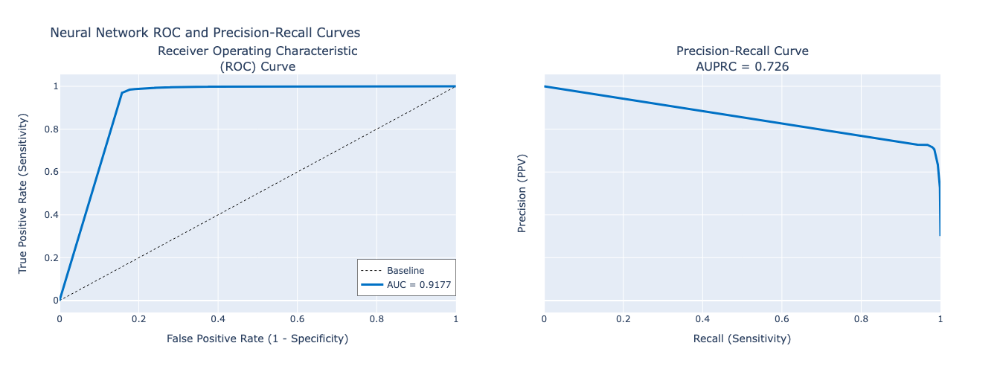

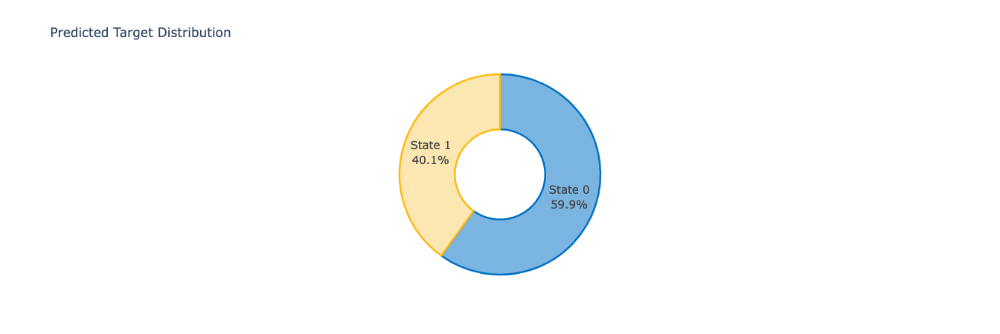

In [17]:
## Initialize MLP (Neural Network) model ##
parameters = {
    'max_iter': 200,
    'random_state': 21
}
nn = MLPClassifier(**parameters)

## Tune Hyperparameters ##
start_tune = time.time()
strat_kfold = StratifiedKFold(n_splits=3, shuffle=True, random_state=21)
print("\nTuning hyperparameters..")

grid = {
    'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.0001, 0.05],
    'learning_rate': ['constant','adaptive']
}
grid_search = RandomizedSearchCV(nn, param_distributions=grid, 
                                    cv=strat_kfold, n_iter=5, scoring='roc_auc', 
                                    verbose=1, n_jobs=-1, random_state=21)
grid_search.fit(X_train, y_train)
    
print("Done!\nBest hyperparameters:", grid_search.best_params_)
print("Best cross-validation AUC: {:.4f}".format(grid_search.best_score_))
print("Tune hyperparameter took: ", time.time() - start_tune)

nn = grid_search.best_estimator_
nn_prob = nn.predict_proba(X_test)[:,1]
nn_pred = pd.Series(nn.predict(X_test), name='Target')
nn_auc = roc_auc_score(y_test, nn_prob)
nn_f1 = f1_score(y_test, nn_pred)  
   
## Print model results ##
print("\nTest F1 accuracy: {:.2f}%, AUC: {:.5f}".format(nn_f1*100,nn_auc))
plot_model_res(model_name='Neural Network', y_test=y_test, y_prob=nn_prob)
